# Credict Card
Чтобы успешно функционировать, банку необходимо быть увереным, что люди, которым он выдаёт кредит, будут возвращать деньги. Оценить это могут помочь методы машинного обучения.
Дана таблица, в которой описаны 30 000 случаев кредитования в Тайване в 2005 году.
В столбцах таблицы представлена информаци о клиентах банка, а именно:
* пол
* возраст
* образование
* семейное положение

А также непосредственно информация о заёме:
* объём кредита
* информация о платежах за предыдущие 6 месяцев (платил ли вовремя или с задержкой)
* количество денег на счету за предыдущие 6 месяцев
* объём платежей по кредиту за предыдущие 6 месяцев
* выплачен ли кредит

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
from matplotlib import pyplot as plt
%matplotlib inline

## 1. Чтение данных

In [2]:
data = pd.read_csv('./data/UCI_Credit_Card.csv', index_col='ID')
data.head(5)

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default.payment.next.month
ID,,,,,,,,,,,,,,,,,,,,,
1,20000.0,2,2,1,24,2,2,-1,-1,-2,...,0.0,0.0,0.0,0.0,689.0,0.0,0.0,0.0,0.0,1
2,120000.0,2,2,2,26,-1,2,0,0,0,...,3272.0,3455.0,3261.0,0.0,1000.0,1000.0,1000.0,0.0,2000.0,1
3,90000.0,2,2,2,34,0,0,0,0,0,...,14331.0,14948.0,15549.0,1518.0,1500.0,1000.0,1000.0,1000.0,5000.0,0
4,50000.0,2,2,1,37,0,0,0,0,0,...,28314.0,28959.0,29547.0,2000.0,2019.0,1200.0,1100.0,1069.0,1000.0,0
5,50000.0,1,2,1,57,-1,0,-1,0,0,...,20940.0,19146.0,19131.0,2000.0,36681.0,10000.0,9000.0,689.0,679.0,0


## 2.1 Основные характеристики данных

In [3]:
data[['LIMIT_BAL', 'SEX', 'EDUCATION', 'MARRIAGE', 'AGE', 'default.payment.next.month']].describe()

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,default.payment.next.month
count,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000
mean,167484.322667,1.603733,1.853133,1.551867,35.485500,0.221200
std,129747.661567,0.489129,0.790349,0.521970,9.217904,0.415062
min,10000.000000,1.000000,0.000000,0.000000,21.000000,0.000000
25%,50000.000000,1.000000,1.000000,1.000000,28.000000,0.000000
50%,140000.000000,2.000000,2.000000,2.000000,34.000000,0.000000
75%,240000.000000,2.000000,2.000000,2.000000,41.000000,0.000000
max,1000000.000000,2.000000,6.000000,3.000000,79.000000,1.000000


In [4]:
data[['PAY_0', 'PAY_2', 'PAY_3', 'PAY_4', 'PAY_5', 'PAY_6']].describe()

,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6
count,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000
mean,-0.016700,-0.133767,-0.166200,-0.220667,-0.266200,-0.291100
std,1.123802,1.197186,1.196868,1.169139,1.133187,1.149988
min,-2.000000,-2.000000,-2.000000,-2.000000,-2.000000,-2.000000
25%,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,8.000000,8.000000,8.000000,8.000000,8.000000,8.000000


In [5]:
for name in ['PAY_0', 'PAY_2', 'PAY_3', 'PAY_4', 'PAY_5', 'PAY_6']:
    print(np.unique(data[[name]]))

[-2 -1  0  1  2  3  4  5  6  7  8]
[-2 -1  0  1  2  3  4  5  6  7  8]
[-2 -1  0  1  2  3  4  5  6  7  8]
[-2 -1  0  1  2  3  4  5  6  7  8]
[-2 -1  0  2  3  4  5  6  7  8]
[-2 -1  0  2  3  4  5  6  7  8]


In [6]:
data[['BILL_AMT1', 'BILL_AMT2', 'BILL_AMT3', 'BILL_AMT4', 'BILL_AMT5', 'BILL_AMT6']].describe()

,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6
count,30000.000000,30000.000000,3.000000e+04,30000.000000,30000.000000,30000.000000
mean,51223.330900,49179.075167,4.701315e+04,43262.948967,40311.400967,38871.760400
std,73635.860576,71173.768783,6.934939e+04,64332.856134,60797.155770,59554.107537
min,-165580.000000,-69777.000000,-1.572640e+05,-170000.000000,-81334.000000,-339603.000000
25%,3558.750000,2984.750000,2.666250e+03,2326.750000,1763.000000,1256.000000
50%,22381.500000,21200.000000,2.008850e+04,19052.000000,18104.500000,17071.000000
75%,67091.000000,64006.250000,6.016475e+04,54506.000000,50190.500000,49198.250000
max,964511.000000,983931.000000,1.664089e+06,891586.000000,927171.000000,961664.000000


In [7]:
data[['PAY_AMT1', 'PAY_AMT2', 'PAY_AMT3', 'PAY_AMT4', 'PAY_AMT5', 'PAY_AMT6']].describe()

,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6
count,30000.000000,3.000000e+04,30000.00000,30000.000000,30000.000000,30000.000000
mean,5663.580500,5.921163e+03,5225.68150,4826.076867,4799.387633,5215.502567
std,16563.280354,2.304087e+04,17606.96147,15666.159744,15278.305679,17777.465775
min,0.000000,0.000000e+00,0.00000,0.000000,0.000000,0.000000
25%,1000.000000,8.330000e+02,390.00000,296.000000,252.500000,117.750000
50%,2100.000000,2.009000e+03,1800.00000,1500.000000,1500.000000,1500.000000
75%,5006.000000,5.000000e+03,4505.00000,4013.250000,4031.500000,4000.000000
max,873552.000000,1.684259e+06,896040.00000,621000.000000,426529.000000,528666.000000


После подсчёта основных характеристик видно, что с датасетом есть некоторые проблемы.

Например, в исходном описании датасета сказано, что столбец 'EDUCATION' принимает значения от 1 до 6 (1 - школа, 2 - университет, 3 - высшая школа, 4 - другое, 5 и 6 - неизвестно). Теперь же видно, что есть ещё и значение 0. Таким образом, будет логично объединить значения 0, 5 и 6 в одно.

Такая же ситуация с 'MARRIAGE' - описанные значения: 1 - женат/замужем, 2 - не состоит в браке, 3 - другое. В самом же датасете присутствует и значение 0.

Также видно, что столбцы 'PAY_0',...,'PAY_6' по описанию должны содержать значения: -1 - выплатил вовремя, 1 - задержка на 1 месяц,..., 8 - задержка на 8 месяцев, 9 - задержка на 9 месяцев или больше. Но в то же время встречаются значения 0 и -2, будем интерпритировать их как -1.

In [3]:
data['EDUCATION'].replace(to_replace={5: 0, 6: 0}, inplace=True)
data['MARRIAGE'].replace(to_replace={3: 0}, inplace=True)
data = data.rename(columns={'PAY_0': 'PAY_1'}) # переименуем столбец 'PAY_0' для удобства
for i in range(1, 7):
    data[f'PAY_{i}'].replace(to_replace={0: -1, -2: -1}, inplace=True)
data[['EDUCATION', 'MARRIAGE', 'PAY_1', 'PAY_2', 'PAY_3', 'PAY_4', 'PAY_5', 'PAY_6']].describe()

,EDUCATION,MARRIAGE,PAY_1,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6
count,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000
mean,1.796267,1.519567,-0.415967,-0.532033,-0.555500,-0.624233,-0.679567,-0.670800
std,0.733242,0.524175,1.142591,1.146393,1.126275,1.067522,1.001726,1.005283
min,0.000000,0.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000
25%,1.000000,1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000
50%,2.000000,2.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000
75%,2.000000,2.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000
max,4.000000,2.000000,8.000000,8.000000,8.000000,8.000000,8.000000,8.000000


## 2.2 Визуализация данных

<AxesSubplot:xlabel='default.payment.next.month', ylabel='Count'>

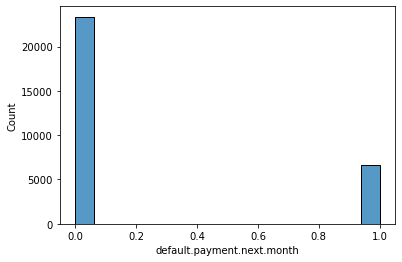

In [7]:
sns.histplot(data['default.payment.next.month'])

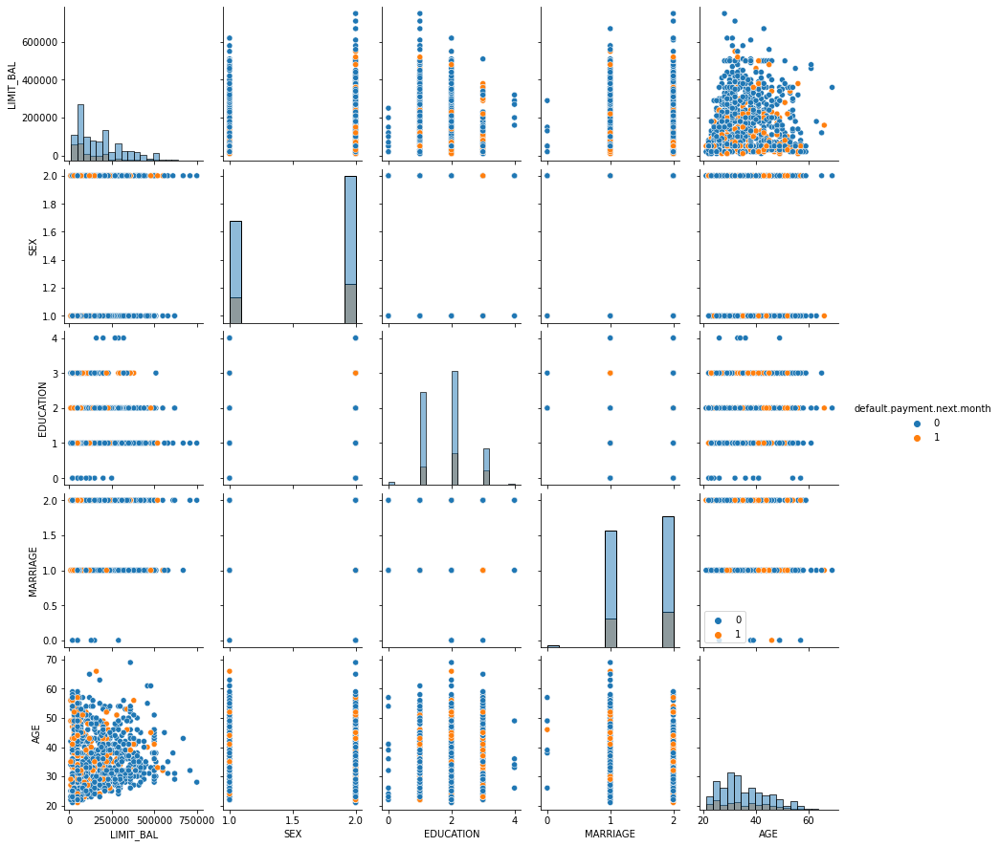

In [9]:
np.random.seed(0)
random_subset = np.random.choice(np.arange(data.shape[0]), size=1000, replace=False)
subdata = data[['LIMIT_BAL', 'SEX', 'EDUCATION', 'MARRIAGE', 'AGE', 'default.payment.next.month']].iloc[random_subset]
sns.pairplot(subdata, hue='default.payment.next.month', diag_kind='hist')
plt.legend()

Посмотрим на гистограммы некоторых признаков

Например, видно, что большая часть кредитов составляет примерно от 0 до $200 000, а возраст клиентов не меньше 21 года, что возможно связано с законодательством Тайваня

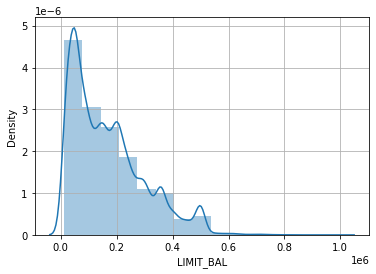

In [10]:
sns.distplot(data['LIMIT_BAL'], bins=15)
plt.grid()

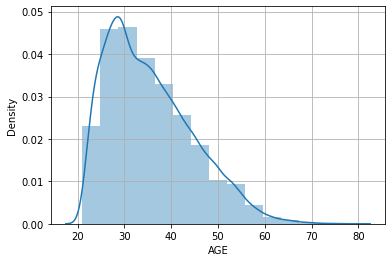

In [11]:
sns.distplot(data['AGE'], bins=15)
plt.grid()

Из следующей диаграммы можно сказать, что большинство заёмщиков плятят без задержек и что те, кто в конечном итоге вылатил кредит, выплачивают его без задержек или с небольшими задержками

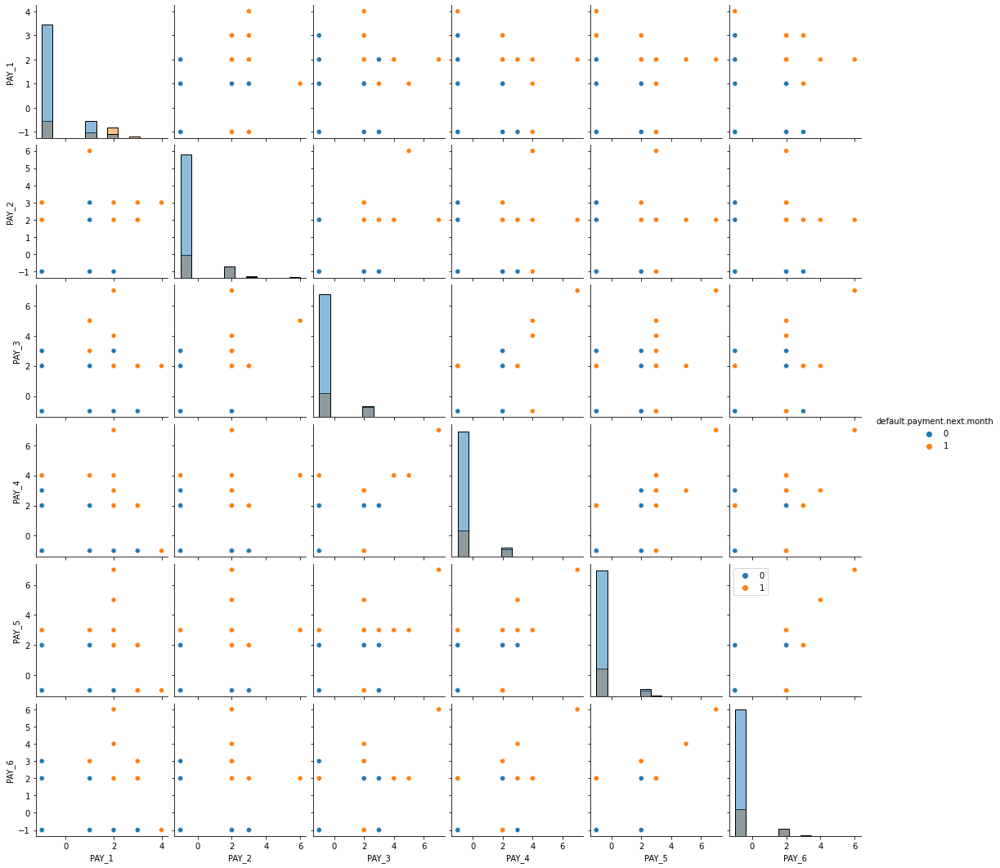

In [12]:
subdata = data[['PAY_1', 'PAY_2', 'PAY_3', 'PAY_4', 'PAY_5', 'PAY_6', 'default.payment.next.month']].iloc[random_subset]
sns.pairplot(subdata, hue='default.payment.next.month', diag_kind='hist')
plt.legend()

Также, можно увидеть, что неоторые люди платят за один месяц очень большие суммы по сравнению с объёмом всего кредита, возможно даже платят всю оставшуюся часть. Такие данные возможно стоит интерпретировать как выбросы

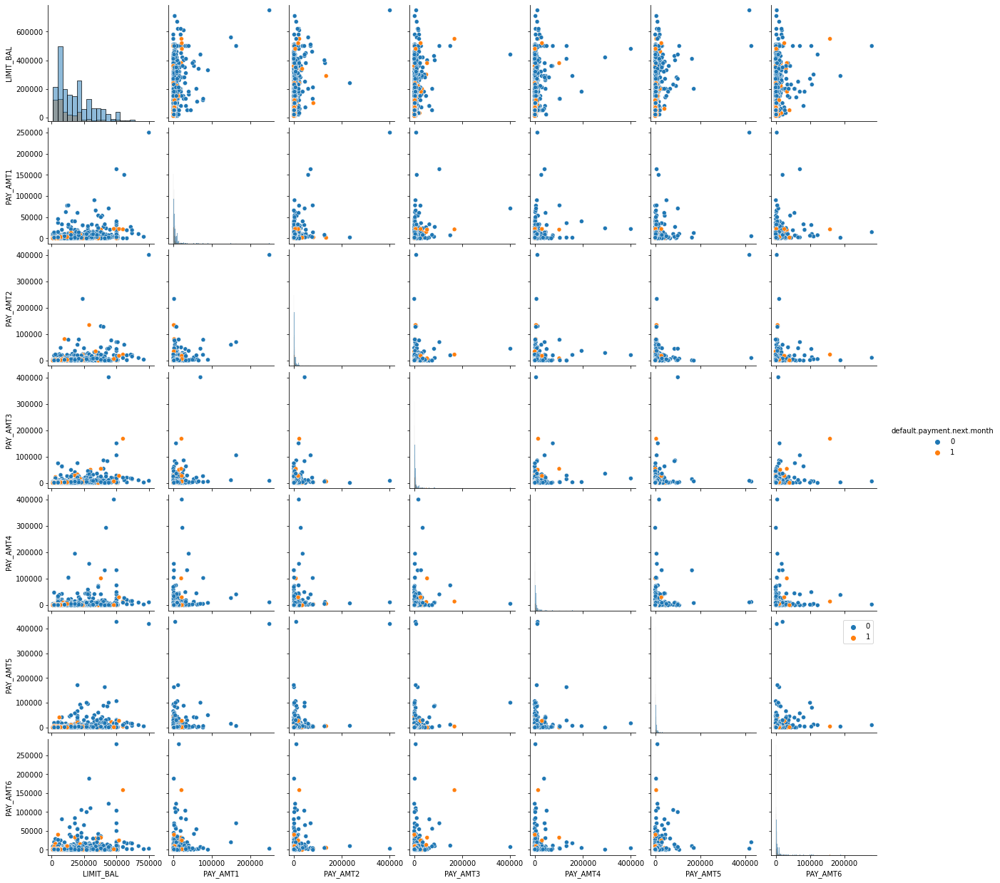

In [13]:
subdata = data[['LIMIT_BAL', 'PAY_AMT1', 'PAY_AMT2', 'PAY_AMT3', 'PAY_AMT4', 'PAY_AMT5', 'PAY_AMT6', 'default.payment.next.month']].iloc[random_subset]
sns.pairplot(subdata, hue='default.payment.next.month', diag_kind='hist')
plt.legend()

Построим матрицу корреляции. Наиболее коррелирующими между собой являются признаки показывающие объём средств на счёте и (BILL\_AMT{i}) и состояния платежей по месяцам (PAY_{i}). Что интерестно так это то, что рамеры платежей по месяцам независимы друг от друга. Также возраст и семейное положение коррелируют между собой

<AxesSubplot:>

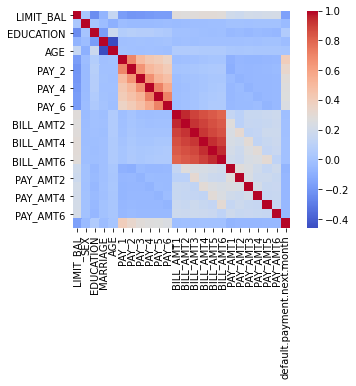

In [14]:
sns.heatmap(data.corr(), square=True, cmap='coolwarm')

## 3. Пропущенные значения

Пропущенных значений в данных нет

In [15]:
data.isna().sum()

LIMIT_BAL                     0
SEX                           0
EDUCATION                     0
MARRIAGE                      0
AGE                           0
PAY_1                         0
PAY_2                         0
PAY_3                         0
PAY_4                         0
PAY_5                         0
PAY_6                         0
BILL_AMT1                     0
BILL_AMT2                     0
BILL_AMT3                     0
BILL_AMT4                     0
BILL_AMT5                     0
BILL_AMT6                     0
PAY_AMT1                      0
PAY_AMT2                      0
PAY_AMT3                      0
PAY_AMT4                      0
PAY_AMT5                      0
PAY_AMT6                      0
default.payment.next.month    0
dtype: int64

## 4. Категориальные признаки
В данных есть 9 категориальных признаков, бинаризуем их

In [12]:
categorical_names = ['SEX', 'EDUCATION', 'MARRIAGE'] + [f'PAY_{i}' for i in range(1, 7)]
dummy_data = pd.get_dummies(data, columns=categorical_names)

In [13]:
list(dummy_data.columns)

['LIMIT_BAL',
 'AGE',
 'BILL_AMT1',
 'BILL_AMT2',
 'BILL_AMT3',
 'BILL_AMT4',
 'BILL_AMT5',
 'BILL_AMT6',
 'PAY_AMT1',
 'PAY_AMT2',
 'PAY_AMT3',
 'PAY_AMT4',
 'PAY_AMT5',
 'PAY_AMT6',
 'default.payment.next.month',
 'SEX_1',
 'SEX_2',
 'EDUCATION_0',
 'EDUCATION_1',
 'EDUCATION_2',
 'EDUCATION_3',
 'EDUCATION_4',
 'MARRIAGE_0',
 'MARRIAGE_1',
 'MARRIAGE_2',
 'PAY_1_-1',
 'PAY_1_1',
 'PAY_1_2',
 'PAY_1_3',
 'PAY_1_4',
 'PAY_1_5',
 'PAY_1_6',
 'PAY_1_7',
 'PAY_1_8',
 'PAY_2_-1',
 'PAY_2_1',
 'PAY_2_2',
 'PAY_2_3',
 'PAY_2_4',
 'PAY_2_5',
 'PAY_2_6',
 'PAY_2_7',
 'PAY_2_8',
 'PAY_3_-1',
 'PAY_3_1',
 'PAY_3_2',
 'PAY_3_3',
 'PAY_3_4',
 'PAY_3_5',
 'PAY_3_6',
 'PAY_3_7',
 'PAY_3_8',
 'PAY_4_-1',
 'PAY_4_1',
 'PAY_4_2',
 'PAY_4_3',
 'PAY_4_4',
 'PAY_4_5',
 'PAY_4_6',
 'PAY_4_7',
 'PAY_4_8',
 'PAY_5_-1',
 'PAY_5_2',
 'PAY_5_3',
 'PAY_5_4',
 'PAY_5_5',
 'PAY_5_6',
 'PAY_5_7',
 'PAY_5_8',
 'PAY_6_-1',
 'PAY_6_2',
 'PAY_6_3',
 'PAY_6_4',
 'PAY_6_5',
 'PAY_6_6',
 'PAY_6_7',
 'PAY_6_8']

## 5. Нормализация данных

In [15]:
data_norm = (dummy_data-dummy_data.min())/(dummy_data.max()-dummy_data.min())

In [16]:
x = np.array(data_norm.drop('default.payment.next.month', axis=1))
y = np.array(data_norm['default.payment.next.month'], dtype=np.int)

In [17]:
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=.1, random_state=0)

In [25]:
from daal4py.sklearn import patch_sklearn
patch_sklearn()

Intel(R) oneAPI Data Analytics Library solvers for sklearn enabled: https://intelpython.github.io/daal4py/sklearn.html


## 6. Без PCA
### 6.1 Logistic Regression

In [18]:
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LogisticRegression

estimator = LogisticRegression(tol=1e-6)
params = {
    'C': [1e-2, 1e-1, 1, 1e+1, 1e+2],
    'fit_intercept': [True, False],
    'class_weight': [None, 'balanced']
}
cv = GridSearchCV(estimator, params, cv=5, verbose=2, scoring='accuracy').fit(x_train, y_train)

Fitting 5 folds for each of 20 candidates, totalling 100 fits
[CV] C=0.01, class_weight=None, fit_intercept=True ...................
[CV] .... C=0.01, class_weight=None, fit_intercept=True, total=   0.2s
[CV] C=0.01, class_weight=None, fit_intercept=True ...................
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.2s remaining:    0.0s
[CV] .... C=0.01, class_weight=None, fit_intercept=True, total=   0.2s
[CV] C=0.01, class_weight=None, fit_intercept=True ...................
[CV] .... C=0.01, class_weight=None, fit_intercept=True, total=   0.2s
[CV] C=0.01, class_weight=None, fit_intercept=True ...................
[CV] .... C=0.01, class_weight=None, fit_intercept=True, total=   0.2s
[CV] C=0.01, class_weight=None, fit_intercept=True ...................
[CV] .... C=0.01, class_weight=None, fit_intercept=True, total=   0.2s
[CV] C=0.01, class_weight=None, fit_intercept=False ...............

In [19]:
cv.best_estimator_

LogisticRegression(C=100.0, tol=1e-06)

In [20]:
cv.best_score_

0.8195925925925925

In [22]:
from sklearn.metrics import accuracy_score

logistic_best_estimator = cv.best_estimator_
accuracy_score(y_test, logistic_best_estimator.predict(x_test))

0.8213333333333334

### 6.2 Linear SVM

In [26]:
from sklearn.svm import SVC

estimator = SVC(kernel='linear')
params = {
    'C': [1e-2, 1e-1, 1, 1e+1, 1e+2],
}
cv = GridSearchCV(estimator, params, cv=5, verbose=2, scoring='accuracy').fit(x_train, y_train)

svc_best_estimator = cv.best_estimator_
svc_score = accuracy_score(y_test, svc_best_estimator.predict(x_test))

Fitting 5 folds for each of 5 candidates, totalling 25 fits
[CV] C=0.01 ..........................................................
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[CV] ........................................... C=0.01, total=   1.7s
[CV] C=0.01 ..........................................................
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.7s remaining:    0.0s
[CV] ........................................... C=0.01, total=   1.8s
[CV] C=0.01 ..........................................................
[CV] ........................................... C=0.01, total=   1.6s
[CV] C=0.01 ..........................................................
[CV] ........................................... C=0.01, total=   1.6s
[CV] C=0.01 ..........................................................
[CV] ........................................... C=0.01, total=   1.6s
[CV] C=0.1 ..........................................................

In [28]:
print(svc_best_estimator)
print(cv.best_score_)
print(svc_score)

SVC(C=0.01, kernel='linear')
0.8187037037037037
0.8266666666666667


### 6.3 RBF SVM

In [31]:
from sklearn.svm import SVC

estimator = SVC(kernel='rbf')
params = {
    'C': [1e-2, 1e-1, 1, 1e+1, 1e+2],
}
cv = GridSearchCV(estimator, params, cv=5, verbose=2, scoring='accuracy').fit(x_train, y_train)

rbf_svc_best_estimator = cv.best_estimator_
rbf_svc_score = accuracy_score(y_test, rbf_svc_best_estimator.predict(x_test))

Fitting 5 folds for each of 5 candidates, totalling 25 fits
[CV] C=0.01 ..........................................................
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[CV] ........................................... C=0.01, total=   2.6s
[CV] C=0.01 ..........................................................
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.6s remaining:    0.0s
[CV] ........................................... C=0.01, total=   1.1s
[CV] C=0.01 ..........................................................
[CV] ........................................... C=0.01, total=   1.1s
[CV] C=0.01 ..........................................................
[CV] ........................................... C=0.01, total=   2.3s
[CV] C=0.01 ..........................................................
[CV] ........................................... C=0.01, total=   1.2s
[CV] C=0.1 ..........................................................

In [32]:
print(rbf_svc_best_estimator)
print(cv.best_score_)
print(rbf_svc_score)

SVC(C=0.1)
0.8200740740740742
0.8256666666666667


### 6.4 Decision Tree

In [33]:
from sklearn.tree import DecisionTreeClassifier

estimator = DecisionTreeClassifier()
params = {
    'criterion': ['gini', 'entropy'],
    'max_depth': [None, 10, 25, 100],
    'min_samples_leaf': [1, 2, 10]
}
cv = GridSearchCV(estimator, params, cv=5, verbose=2, scoring='accuracy').fit(x_train, y_train)

tree_best_estimator = cv.best_estimator_
tree_score = accuracy_score(y_test, tree_best_estimator.predict(x_test))

Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV] criterion=gini, max_depth=None, min_samples_leaf=1 ..............
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[CV]  criterion=gini, max_depth=None, min_samples_leaf=1, total=   0.5s
[CV] criterion=gini, max_depth=None, min_samples_leaf=1 ..............
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.5s remaining:    0.0s
[CV]  criterion=gini, max_depth=None, min_samples_leaf=1, total=   0.5s
[CV] criterion=gini, max_depth=None, min_samples_leaf=1 ..............
[CV]  criterion=gini, max_depth=None, min_samples_leaf=1, total=   0.5s
[CV] criterion=gini, max_depth=None, min_samples_leaf=1 ..............
[CV]  criterion=gini, max_depth=None, min_samples_leaf=1, total=   0.6s
[CV] criterion=gini, max_depth=None, min_samples_leaf=1 ..............
[CV]  criterion=gini, max_depth=None, min_samples_leaf=1, total=   0.6s
[CV] criterion=gini, max_depth=None, min_samples_leaf=2 ......

In [34]:
print(tree_best_estimator)
print(cv.best_score_)
print(tree_score)

DecisionTreeClassifier(criterion='entropy', max_depth=10, min_samples_leaf=2)
0.810074074074074
0.8113333333333334


### 6.5 Random Forest

In [35]:
from sklearn.ensemble import RandomForestClassifier

estimator = RandomForestClassifier()
params = {
    'n_estimators': [2, 10, 100, 1000],
    'criterion': ['gini', 'entropy'],
    'max_depth': [None, 10, 25, 100],
    'min_samples_leaf': [1, 2, 10]
}
cv = GridSearchCV(estimator, params, cv=5, verbose=2, scoring='accuracy').fit(x_train, y_train)

tree_best_estimator = cv.best_estimator_
tree_score = accuracy_score(y_test, tree_best_estimator.predict(x_test))

_depth=25, min_samples_leaf=1, n_estimators=2 
[CV]  criterion=entropy, max_depth=25, min_samples_leaf=1, n_estimators=2, total=   0.1s
[CV] criterion=entropy, max_depth=25, min_samples_leaf=1, n_estimators=2 
[CV]  criterion=entropy, max_depth=25, min_samples_leaf=1, n_estimators=2, total=   0.1s
[CV] criterion=entropy, max_depth=25, min_samples_leaf=1, n_estimators=2 
[CV]  criterion=entropy, max_depth=25, min_samples_leaf=1, n_estimators=2, total=   0.1s
[CV] criterion=entropy, max_depth=25, min_samples_leaf=1, n_estimators=2 
[CV]  criterion=entropy, max_depth=25, min_samples_leaf=1, n_estimators=2, total=   0.1s
[CV] criterion=entropy, max_depth=25, min_samples_leaf=1, n_estimators=10 
[CV]  criterion=entropy, max_depth=25, min_samples_leaf=1, n_estimators=10, total=   0.7s
[CV] criterion=entropy, max_depth=25, min_samples_leaf=1, n_estimators=10 
[CV]  criterion=entropy, max_depth=25, min_samples_leaf=1, n_estimators=10, total=   0.7s
[CV] criterion=entropy, max_depth=25, min_sam

In [39]:
forest_best_estimator = tree_best_estimator
forest_score = tree_score

In [40]:
print(forest_best_estimator)
print(cv.best_score_)
print(forest_score)

RandomForestClassifier(criterion='entropy', max_depth=10, min_samples_leaf=10,
                       n_estimators=1000)
0.8204444444444444
0.8246666666666667


### 6.6 Gradient Boosting

In [52]:
from xgboost import XGBClassifier

estimator = XGBClassifier()
params = {
    'n_estimators': [2, 10, 50, 100, 500, 1000],
    'max_depth': [None, 5, 10, 25, 100]
}
cv = GridSearchCV(estimator, params, cv=5, verbose=2, scoring='accuracy').fit(x_train, y_train)

xgboost_best_estimator = cv.best_estimator_
xgboost_score = accuracy_score(y_test, tree_best_estimator.predict(x_test))

.. max_depth=None, n_estimators=10, total=   0.3s
[CV] max_depth=None, n_estimators=50 .................................
[CV] .................. max_depth=None, n_estimators=50, total=   1.0s
[CV] max_depth=None, n_estimators=50 .................................
[CV] .................. max_depth=None, n_estimators=50, total=   1.1s
[CV] max_depth=None, n_estimators=50 .................................
[CV] .................. max_depth=None, n_estimators=50, total=   1.0s
[CV] max_depth=None, n_estimators=50 .................................
[CV] .................. max_depth=None, n_estimators=50, total=   1.4s
[CV] max_depth=None, n_estimators=50 .................................
[CV] .................. max_depth=None, n_estimators=50, total=   1.0s
[CV] max_depth=None, n_estimators=100 ................................
[CV] ................. max_depth=None, n_estimators=100, total=   2.0s
[CV] max_depth=None, n_estimators=100 ................................
[CV] ................. max_

In [53]:
print(xgboost_best_estimator)
print(cv.best_score_)
print(xgboost_score)

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.300000012, max_delta_step=0, max_depth=5,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=10, n_jobs=0, num_parallel_tree=1, random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)
0.819925925925926
0.8246666666666667


## 7. PCA

In [43]:
f'Всего признаков после бинаризации: {x.shape[1]}'

'Всего признаков после бинаризации: 76'

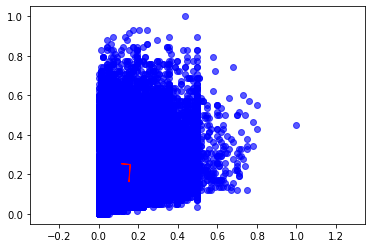

In [46]:
from sklearn.decomposition import PCA

pca = PCA(n_components=2).fit(x)
v0 = pca.components_[0]
v1 = pca.components_[1]

plt.scatter(x[:, 0], x[:, 1], color='b', alpha = 0.65)
plt.arrow(pca.mean_[0], pca.mean_[1], v0[0], v0[1], color = 'r')
plt.arrow(pca.mean_[0], pca.mean_[1], v1[0], v1[1], color = 'r')
plt.axis('equal');

In [51]:
pca.components_[:, :2]

array([[-0.04022685,  0.00360464],
       [-0.00617902, -0.08370286]])

In [49]:
pca.explained_variance_

array([0.70238649, 0.52806914])

In [55]:
components = list(range(1, x.shape[1]+1))
train_errors = []
test_errors = []
for n_components in components:
    pca = PCA(n_components=n_components).fit(x_train)
    pca_x_train = pca.transform(x_train)
    pca_x_test = pca.transform(x_test)

    svm = SVC(kernel='linear', C=.01).fit(pca_x_train, y_train)
    train_error = 1-accuracy_score(y_train, svm.predict(pca_x_train))
    test_error = 1-accuracy_score(y_test, svm.predict(pca_x_test))
    train_errors.append(train_error)
    test_errors.append(test_error)
    print(f'{n_components}:\t{train_error}\t{test_error}')

1:	0.19499999999999995	0.19833333333333336
2:	0.196037037037037	0.19533333333333336
3:	0.19451851851851854	0.19499999999999995
4:	0.19548148148148148	0.19633333333333336
5:	0.199962962962963	0.20099999999999996
6:	0.200037037037037	0.20133333333333336
7:	0.2012222222222222	0.19766666666666666
8:	0.1926296296296296	0.18733333333333335
9:	0.18325925925925923	0.17566666666666664
10:	0.1876296296296296	0.18300000000000005
11:	0.1876296296296296	0.18300000000000005
12:	0.18485185185185182	0.18133333333333335
13:	0.1832962962962963	0.17900000000000005
14:	0.1832962962962963	0.17900000000000005
15:	0.1832962962962963	0.17900000000000005
16:	0.1832962962962963	0.17900000000000005
17:	0.184037037037037	0.18000000000000005
18:	0.18125925925925923	0.17333333333333334
19:	0.18125925925925923	0.17333333333333334
20:	0.18118518518518523	0.17333333333333334
21:	0.18125925925925923	0.17366666666666664
22:	0.18125925925925923	0.17366666666666664
23:	0.18118518518518523	0.17333333333333334
24:	0.1811851

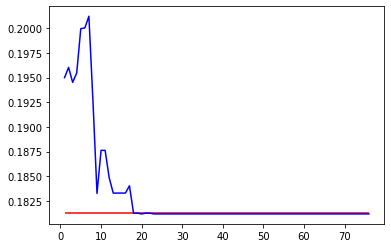

In [57]:
ref_train_error = 1-0.8187037037037037
plt.plot(components, train_errors, color='b')
plt.hlines(ref_train_error, components[0], components[-1], color='r')

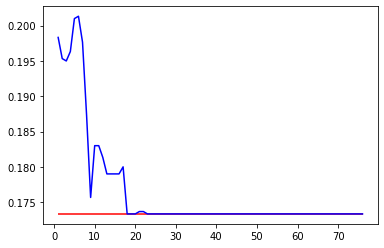

In [58]:
ref_test_error = 1-0.8266666666666667
plt.plot(components, test_errors, color='b')
plt.hlines(ref_test_error, components[0], components[-1], color='r')

## 8. LDA

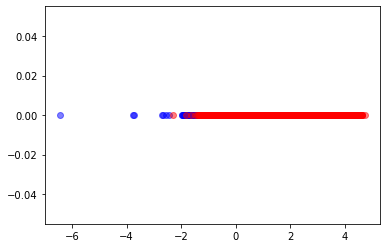

In [74]:
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis

lda = LinearDiscriminantAnalysis(n_components=1).fit(x, y)
x_lda = lda.transform(x)

plt.scatter(x_lda[y == 0, 0], [0 for _ in x_lda[y == 0, 0]], color='b', alpha = 0.5)
plt.scatter(x_lda[y == 1, 0], [0 for _ in x_lda[y == 1, 0]], color='r', alpha = 0.5)